In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from statsmodels.tsa.seasonal import seasonal_decompose

In [2]:
df = df = pd.read_excel("/Users/hachikaruanyakwee/Documents/Git Hub/Online_Retail_EDA/Online_Retail_durry.xlsx") #Import dataset

In [3]:
pd.set_option('display.max_columns', 200) #Display all columns

In [4]:
df.head() #Display the top 5 rows

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,TotalSales,CustomerID,GuestOrders,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,2010-12-01 08:26:00,2.55,15.30,17850,0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,2010-12-01 08:26:00,3.39,20.34,17850,0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,2010-12-01 08:26:00,2.75,22.00,17850,0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,2010-12-01 08:26:00,3.39,20.34,17850,0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,2010-12-01 08:26:00,3.39,20.34,17850,0,United Kingdom


In [5]:
df.tail()  #Display the last 5 rows

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,TotalSales,CustomerID,GuestOrders,Country
399651,581587,22613,PACK OF 20 SPACEBOY NAPKINS,12,2011-12-09 12:50:00,0.85,10.20,12680,0,France
399652,581587,22899,CHILDREN'S APRON DOLLY GIRL,6,2011-12-09 12:50:00,2.10,12.60,12680,0,France
399653,581587,23254,CHILDRENS CUTLERY DOLLY GIRL,4,2011-12-09 12:50:00,4.15,16.60,12680,0,France
399654,581587,23255,CHILDRENS CUTLERY CIRCUS PARADE,4,2011-12-09 12:50:00,4.15,16.60,12680,0,France
399655,581587,22138,BAKING SET 9 PIECE RETROSPOT,3,2011-12-09 12:50:00,4.95,14.85,12680,0,France


In [6]:
df.reset_index(inplace=True)

In [7]:
print("\nDataset overview:")
df.info()  #Overview of the dataset, including column types and null counts


Dataset overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399656 entries, 0 to 399655
Data columns (total 11 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   index        399656 non-null  int64         
 1   InvoiceNo    399656 non-null  object        
 2   StockCode    399656 non-null  object        
 3   Description  399656 non-null  object        
 4   Quantity     399656 non-null  int64         
 5   InvoiceDate  399656 non-null  datetime64[ns]
 6   UnitPrice    399656 non-null  float64       
 7   TotalSales   399656 non-null  float64       
 8   CustomerID   399656 non-null  int64         
 9   GuestOrders  399656 non-null  int64         
 10  Country      399656 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(4), object(4)
memory usage: 33.5+ MB


In [8]:
df.shape  #Number of rows and columns

(399656, 11)

In [9]:
#Statistical summary
print("\nStatistical Summary:")
print(df.describe(include='all'))  #Summary statistics for numerical and categorical data



Statistical Summary:
                index  InvoiceNo StockCode  \
count   399656.000000   399656.0    399656   
unique            NaN    21785.0      3676   
top               NaN   576339.0    85123A   
freq              NaN      541.0      2065   
mean    199827.500000        NaN       NaN   
min          0.000000        NaN       NaN   
25%      99913.750000        NaN       NaN   
50%     199827.500000        NaN       NaN   
75%     299741.250000        NaN       NaN   
max     399655.000000        NaN       NaN   
std     115370.893929        NaN       NaN   

                               Description       Quantity  \
count                               399656  399656.000000   
unique                                3888            NaN   
top     WHITE HANGING HEART T-LIGHT HOLDER            NaN   
freq                                  2058            NaN   
mean                                   NaN      12.195671   
min                                    NaN  -80995.000000  

In [10]:
df.isnull().sum()  #Number of missing values in each column.

index          0
InvoiceNo      0
StockCode      0
Description    0
Quantity       0
InvoiceDate    0
UnitPrice      0
TotalSales     0
CustomerID     0
GuestOrders    0
Country        0
dtype: int64

In [11]:
df.isnull().mean() * 100  #Returns the percentage of missing values.

index          0.0
InvoiceNo      0.0
StockCode      0.0
Description    0.0
Quantity       0.0
InvoiceDate    0.0
UnitPrice      0.0
TotalSales     0.0
CustomerID     0.0
GuestOrders    0.0
Country        0.0
dtype: float64

In [12]:
df['CustomerID'].nunique()  #Checking for number of subscribers

4362

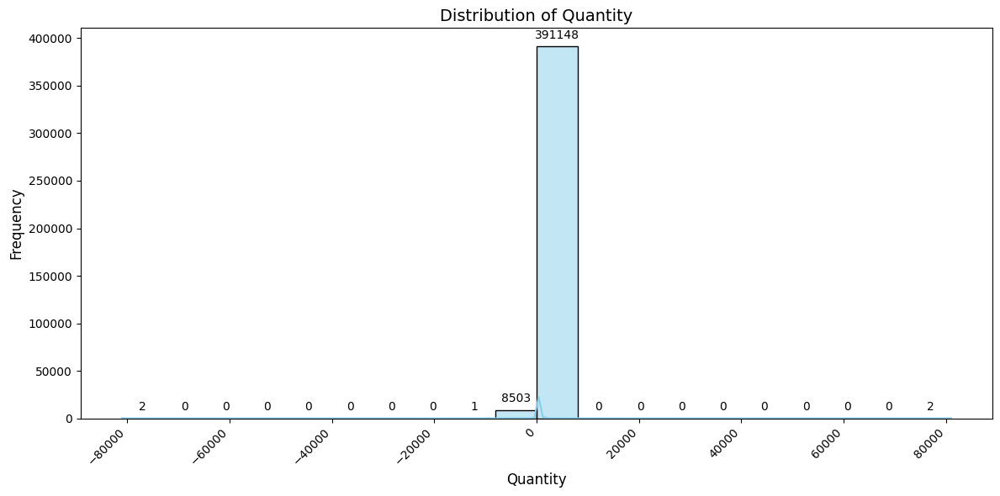

In [13]:
#Distribution of Sales
def plot_numerical_distribution(df, numerical_col, title, bins=20, kde=True, color='skyblue'):
    
    #Create the plot
    plt.figure(figsize=(12, 6))
    
    ax = sns.histplot(
        data=df,
        x=numerical_col,
        bins=bins,
        kde=kde,
        color=color
    )
    
    #Add title and labels
    plt.title(title, fontsize=14)
    plt.xlabel(numerical_col, fontsize=12)
    plt.ylabel('Frequency', fontsize=12)
    
    #Add data labels manually (approximating counts for bars)
    for p in ax.patches:
        height = p.get_height()
        ax.annotate(f'{height:.0f}', 
                    (p.get_x() + p.get_width() / 2., height), 
                    ha='center', 
                    va='center', 
                    fontsize=10, 
                    color='black', 
                    xytext=(0, 10),  #Adjust vertical positioning
                    textcoords='offset points')
    
    #Customize
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for readability
    plt.tight_layout()  #Adjust layout to prevent clipping of labels
    plt.show()

#Callfunction
plot_numerical_distribution(df, 'Quantity', 'Distribution of Quantity')

# Interpretation:
The order quantities show a clear right skew, meaning most orders contain only a small number of items, likely just one unit. You can see this in the high frequency of orders with a quantity of 1. Although there are a few orders with much larger quantities, they make up a smaller portion of the total.

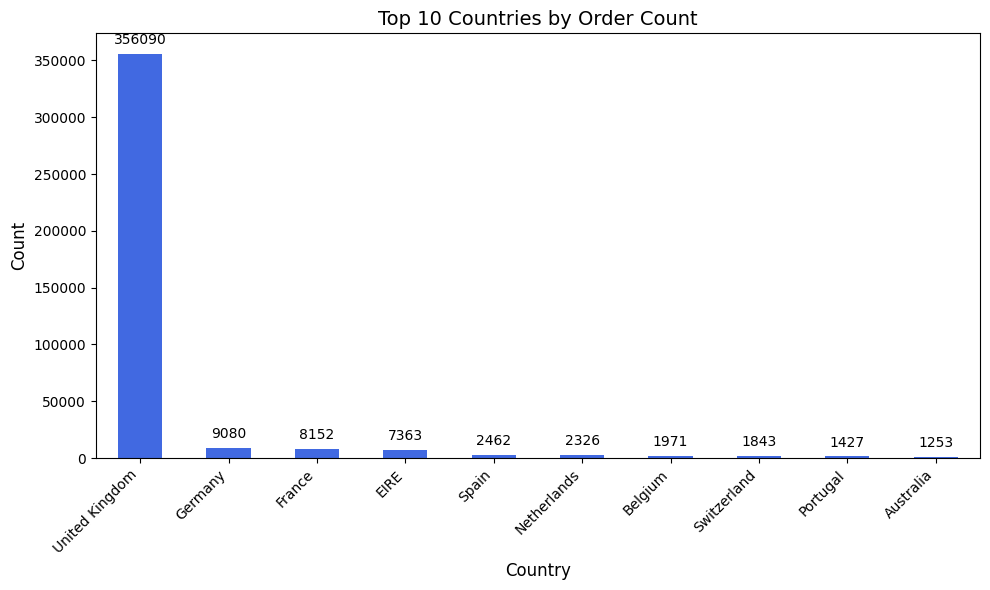

In [14]:
#Trending Regions(OrderCount)
def plot_categorical_data(df, category_col, title, max_categories=10, color='royalblue'):
    #Value counts and limit to the top categories
    value_counts = df[category_col].value_counts().head(max_categories)

    #Create the plot
    plt.figure(figsize=(10, 6))
    ax = value_counts.plot(kind='bar', color=color)

    #Add title and labels
    plt.title(title, fontsize=14)
    plt.xlabel(category_col, fontsize=12)
    plt.ylabel('Count', fontsize=12)

    #Add data labels with automatic positioning
    for container in ax.containers:
        ax.bar_label(container, fontsize=10, padding=5)

    #Customize
    plt.xticks(rotation=45, ha='right')  #Rotate x-axis labels for readability
    plt.tight_layout()  #Adjust layout to prevent clipping of labels
    plt.show()

#Call the function
plot_categorical_data(df, 'Country', 'Top 10 Countries by Order Count')

In [15]:
#Feature Engineering - Adding new columns

#Ensure InvoiceDate is a datetime object
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

#Extract Year and Month from InvoiceDate
df['YearMonth'] = df['InvoiceDate'].dt.to_period('M')

#Aggregate daily sales to monthly sales
monthly_sales = df.groupby('YearMonth')['TotalSales'].sum().reset_index()

#Merge the aggregated monthly sales back to the original DataFrame
df = pd.merge(df, monthly_sales, on='YearMonth', how='left', suffixes=('', '_Monthly'))

#Display the first few rows to verify the new column
print(df[['InvoiceDate', 'TotalSales', 'YearMonth', 'TotalSales_Monthly']].head())


          InvoiceDate  TotalSales YearMonth  TotalSales_Monthly
0 2010-12-01 08:26:00       15.30   2010-12           547893.92
1 2010-12-01 08:26:00       20.34   2010-12           547893.92
2 2010-12-01 08:26:00       22.00   2010-12           547893.92
3 2010-12-01 08:26:00       20.34   2010-12           547893.92
4 2010-12-01 08:26:00       20.34   2010-12           547893.92


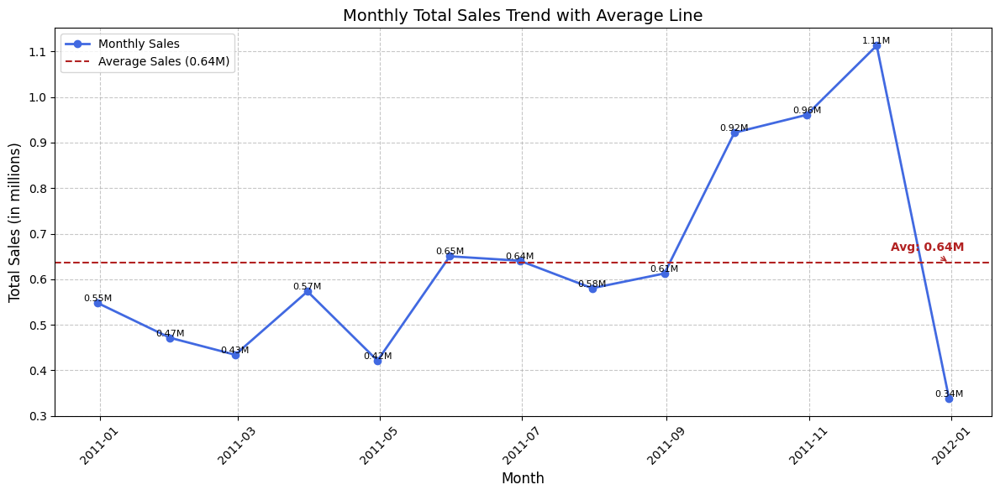

In [16]:
#Sales Trend
def create_time_trend_chart(df):
    #Ensure datetime format for 'InvoiceDate' and set as index
    df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])  #Ensure the correct datetime format
    df.set_index('InvoiceDate', inplace=True)

    #Resample monthly and sum 'TotalSales'
    monthly_sales = df['TotalSales'].resample('ME').sum()

    #Convert the sales to millions
    monthly_sales_in_millions = monthly_sales / 1e6

    #Plotting
    fig, ax = plt.subplots(figsize=(12, 6))  #Adjust figure size

    #Plot the time trend
    ax.plot(monthly_sales_in_millions.index, monthly_sales_in_millions, 
            color='royalblue', marker='o', linewidth=2, label='Monthly Sales')

    #Add data labels for each point
    for i, (x, y) in enumerate(zip(monthly_sales_in_millions.index, monthly_sales_in_millions)):
        ax.annotate(f'{y:.2f}M', xy=(x, y), ha='center', va='bottom', fontsize=8)

    #Add average sales trendline
    average_sales = monthly_sales_in_millions.mean()
    ax.axhline(y=average_sales, color='firebrick', linestyle='--', label=f'Average Sales ({average_sales:.2f}M)')

    #Add label for the average sales trendline
    ax.annotate(f'Avg: {average_sales:.2f}M', 
                xy=(monthly_sales_in_millions.index[-1], average_sales),
                xytext=(-50, 10), 
                textcoords='offset points', 
                color='firebrick', fontsize=10, fontweight='bold', 
                arrowprops=dict(arrowstyle='->', color='firebrick'))

    #Customize plot appearance
    ax.set_title('Monthly Total Sales Trend with Average Line', fontsize=14)
    ax.set_xlabel('Month', fontsize=12)
    ax.set_ylabel('Total Sales (in millions)', fontsize=12)
    ax.grid(True, linestyle='--', alpha=0.7)  #Add grid lines
    ax.tick_params(axis='x', rotation=45)
    ax.legend(fontsize=10)

    #Tight layout for better spacing
    plt.tight_layout()
    plt.show()

#Call the function
create_time_trend_chart(df)

# Interpretation:
The chart shows a clear sales trend, marked by steady growth and noticeable seasonality. The upward trend highlights consistent progress over time, while the monthly fluctuations point to a strong seasonal influence. Sales are highest in March and September, with drops in April and July, hinting at a possible six-month seasonal cycle.

In [17]:
#Exploring Relationships

import plotly.express as px

def plot_interactive_scatter(df, x_col, y_col, title):
    

    #Create an interactive scatter plot using Plotly
    fig = px.scatter(
        df,
        x=x_col,
        y=y_col,
        color='Country',  #Add interactivity by colouring points by country
        hover_name='Description',  #Display Description on hover
        title=f'{title}'  #Add title
    )
    
    #Show the interactive plot
    fig.show()

plot_interactive_scatter(df, 'UnitPrice', 'Quantity', 'Interactive Scatter Plot of UnitPrice vs Quantity')


# Interpretation:
The scatter plot shows that most orders consist of small quantities of items at lower prices, with data points clustering around lower UnitPrice and Quantity values. Although there are a few outliers with higher UnitPrice and Quantity values, they make up a smaller share of the overall data. The chart also suggests that order patterns might vary across countries, with certain countries showing higher concentrations of orders in specific UnitPrice and Quantity ranges.

In [18]:
#Feature engineering - Adding new columns
df['Revenue'] = df['Quantity'] * df['UnitPrice']  #Total revenue per item
df['ProfitMargin'] = df['Revenue'] * 0.2  #Assuming a fixed profit margin

In [19]:
def plot_treemap(df, group_col, value_col, title, color_col=None, color_scale='viridis'):
    
    #Ensure that the 'ProfitMargin' is numeric
    df[value_col] = pd.to_numeric(df[value_col], errors='coerce')

    #Drop rows where the group column or value column are null
    df_clean = df.dropna(subset=[group_col, value_col])

    #Group data and calculate the sum of the value column
    if color_col is None:
        grouped_data = df_clean.groupby(group_col)[value_col].sum().reset_index()
    else:
        grouped_data = df_clean.groupby([group_col, color_col])[value_col].sum().reset_index()

    #Ensure column is treated as categorical
    grouped_data[group_col] = grouped_data[group_col].astype(str)

    #Create the Treemap chart using plotly
    fig = px.treemap(
        grouped_data,
        path=[group_col],  #grouping by Description
        values=value_col,  #Values to size the blocks by ProfitMargin
        color=color_col,  #Color the blocks by the specified column
        color_continuous_scale=color_scale,  #Colour scale for the blocks
        title=title  #Add Title
    )

    #Show the Treemap
    fig.show()

plot_treemap(df, 'Description', 'ProfitMargin', 'Treemap of Products by Profit Margin')

# Interpretation:
The treemap offers a clear view of the Products hierarchy, with larger rectangles representing higher-level products. The color and size of each rectangle reflect the total profit margin, giving a quick snapshot of profitability across different products. The treemap highlights a wide range of profit margins, with certain products standing out for their higher profits.

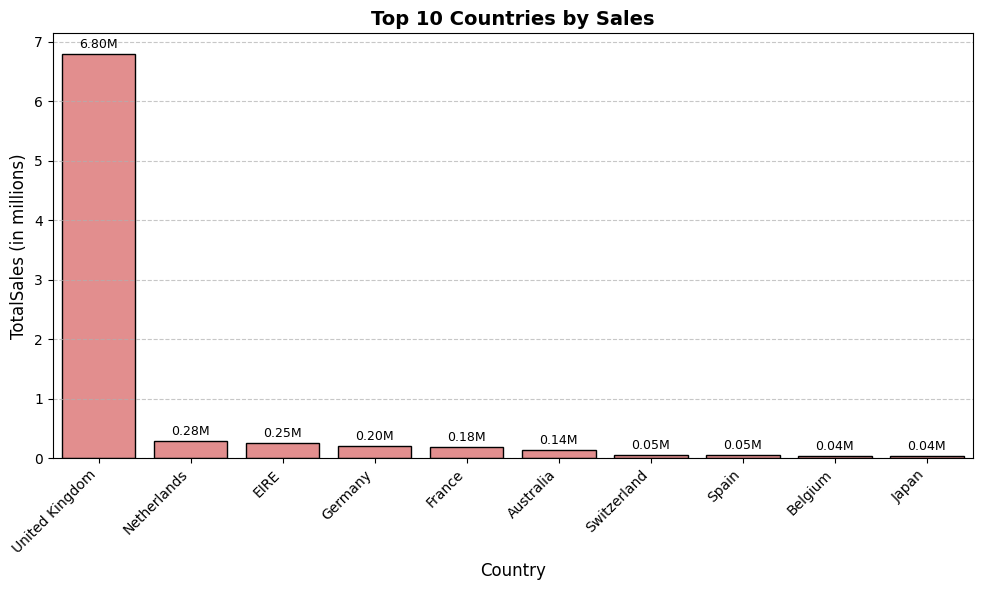

In [20]:
#Ranking Top Countries By Sales
def plot_aggregation(df, group_col, value_col, title, max_categories=10, color='lightcoral'):
    #Aggregate total sales and convert to millions
    aggregated_data = df.groupby(group_col)[value_col].sum().sort_values(ascending=False).head(max_categories)
    aggregated_data_in_millions = aggregated_data / 1e6  #Convert to millions

    #Prepare the data
    aggregated_df = aggregated_data_in_millions.reset_index()
    aggregated_df.columns = [group_col, 'TotalSales_$M']  

    #Plot the bar chart
    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=aggregated_df,
        x=group_col,
        y='TotalSales_$M',
        color=color,
        edgecolor="black"
    )

    #Add data labels
    for index, row in aggregated_df.iterrows():
        plt.text(index, row['TotalSales_$M'] + 0.05, f'{row["TotalSales_$M"]:.2f}M',
                 ha='center', va='bottom', fontsize=9)

    #Customize the plot
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel(group_col, fontsize=12)
    plt.ylabel(f'{value_col} (in millions)', fontsize=12)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()

    #Show the plot
    plt.show()

#Call the function
plot_aggregation(df, 'Country', 'TotalSales', 'Top 10 Countries by Sales')

# Interpretation:
The bar chart highlights the United Kingdom as the clear leader in sales, far outpacing other countries in the top 10. While the Netherlands and EIRE show some potential, the UK's sales volume stands out as significantly higher. This analysis underscores the importance of the UK market, suggesting that maintaining and possibly expanding market share there should be a key focus. At the same time, it’s crucial to explore and develop other growing markets like the Netherlands and EIRE.

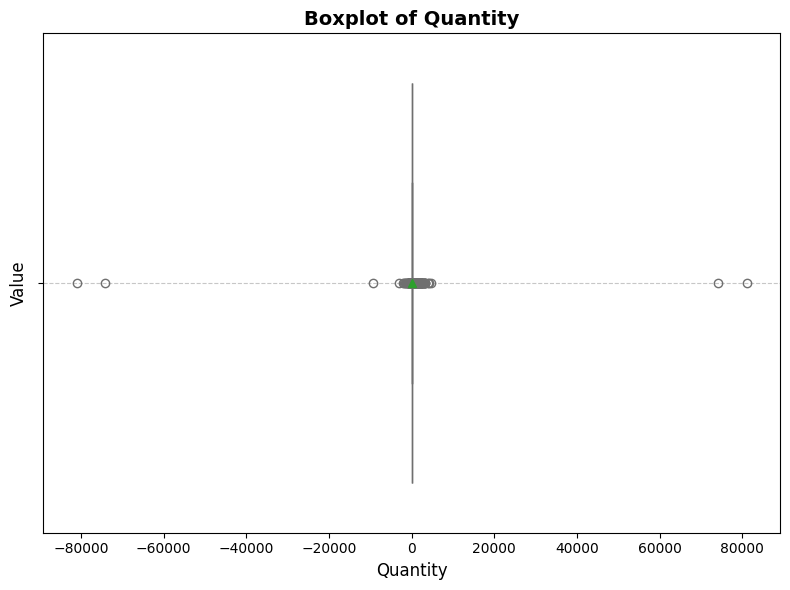

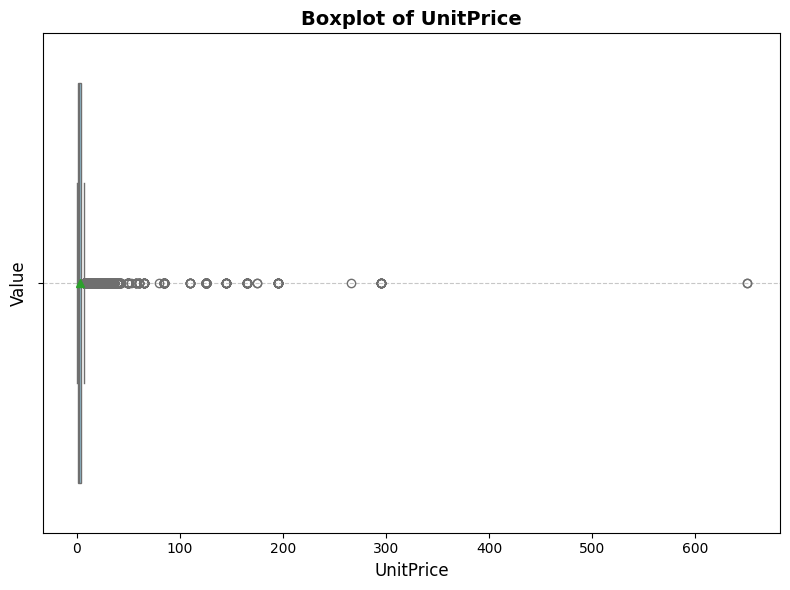

Outliers in 'Quantity': 26588
Outliers in 'UnitPrice': 34222


In [21]:
#Outlier Detection

def plot_boxplot(df, numerical_col):
    
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=df[numerical_col], color='skyblue', showmeans=True)
    plt.title(f'Boxplot of {numerical_col}', fontsize=14, weight='bold')
    plt.xlabel(numerical_col, fontsize=12)
    plt.ylabel('Value', fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

#Detecting Outliers using IQR
def detect_outliers_iqr(data):
   
    q1 = data.quantile(0.25)  #First quartile
    q3 = data.quantile(0.75)  #Third quartile
    iqr = q3 - q1             #Interquartile range
    lower_bound = q1 - 1.5 * iqr  #Lower threshold for outliers
    upper_bound = q3 + 1.5 * iqr  #Upper threshold for outliers
    return (data < lower_bound) | (data > upper_bound)

#Testing with 'Quantity' and 'UnitPrice'
plot_boxplot(df, 'Quantity')
plot_boxplot(df, 'UnitPrice')

#Adding outlier flags
df['Quantity_Outlier'] = detect_outliers_iqr(df['Quantity'])
df['UnitPrice_Outlier'] = detect_outliers_iqr(df['UnitPrice'])

#Display summary
print("Outliers in 'Quantity':", df['Quantity_Outlier'].sum())
print("Outliers in 'UnitPrice':", df['UnitPrice_Outlier'].sum())

# Interpretation: 

Both the UnitPrice and Quantity distributions exhibit significant right-skewness, indicating that a majority of products have lower prices and order quantities, while a smaller proportion have very high values. This is evident in the long tails extending towards higher values in both boxplots.

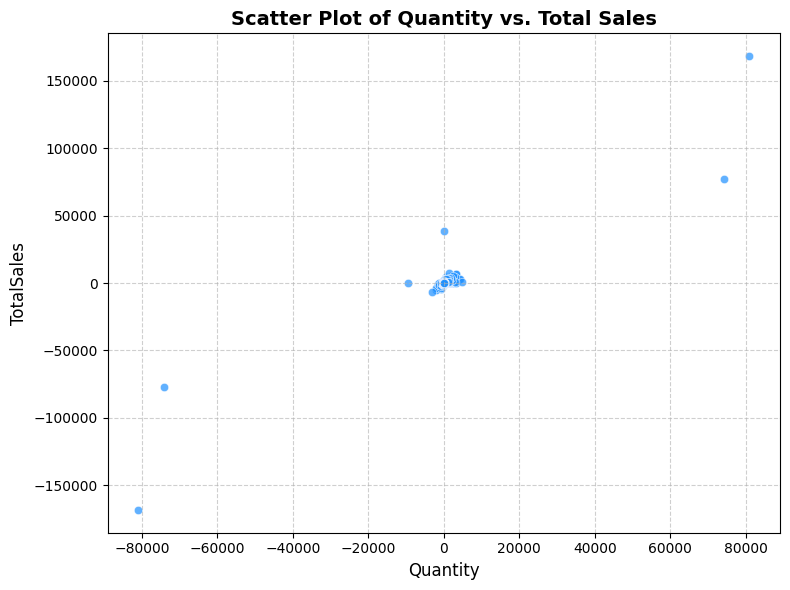

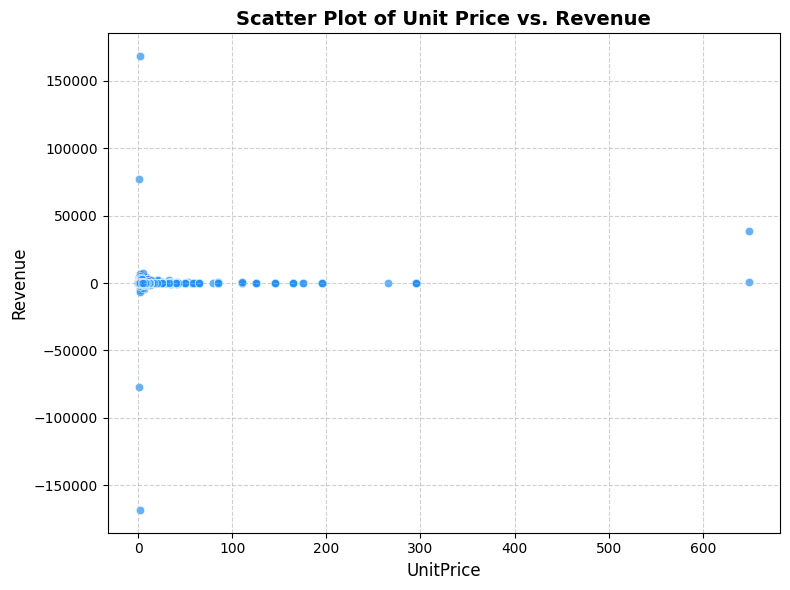

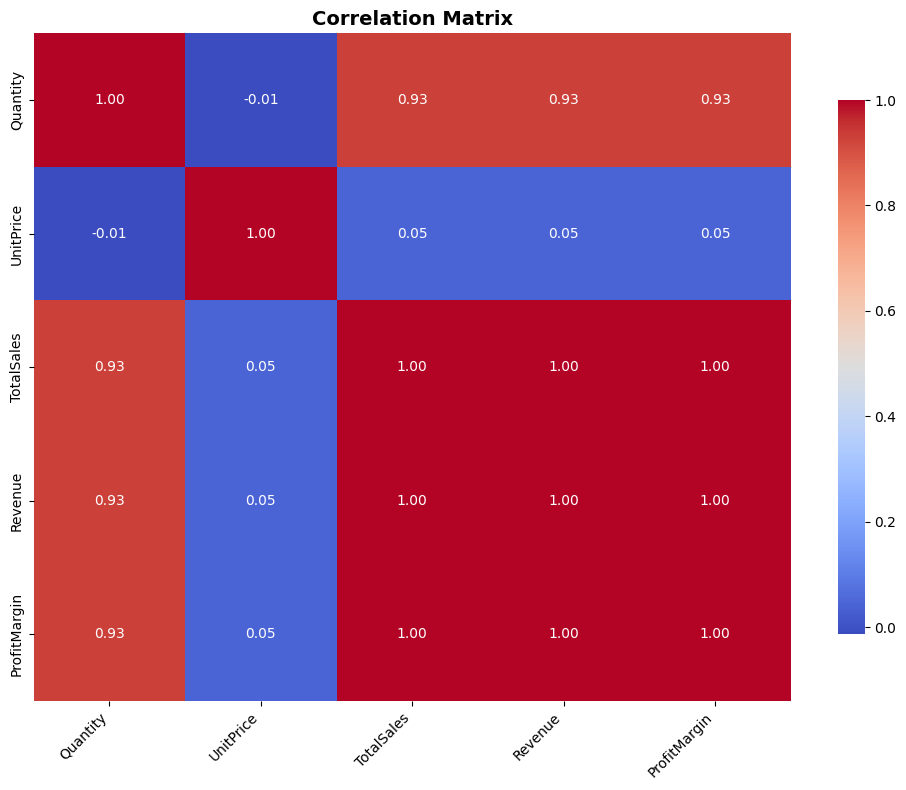

In [22]:
#Relationship Exploration
def plot_scatter(df, x_col, y_col, title):
   
    plt.figure(figsize=(8, 6))
    sns.scatterplot(data=df, x=x_col, y=y_col, color='dodgerblue', alpha=0.7)
    plt.title(title, fontsize=14, weight='bold')
    plt.xlabel(x_col, fontsize=12)
    plt.ylabel(y_col, fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)  #Add grid lines
    plt.tight_layout()
    plt.show()

#Check how 'Quantity' and 'TotalSales' relate
plot_scatter(df, 'Quantity', 'TotalSales', 'Scatter Plot of Quantity vs. Total Sales')

#Check how 'UnitPrice' and 'Revenue' relate
plot_scatter(df, 'UnitPrice', 'Revenue', 'Scatter Plot of Unit Price vs. Revenue')

#Function to create and display a correlation matrix
def plot_correlation_matrix(df, title='Correlation Matrix', cmap='coolwarm'):
    
    corr_matrix = df.corr()  #Compute correlation matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(corr_matrix, annot=True, cmap=cmap, fmt=".2f", cbar_kws={'shrink': 0.8})
    plt.title(title, fontsize=14, weight='bold')
    plt.xticks(fontsize=10, rotation=45, ha='right')
    plt.yticks(fontsize=10)
    plt.tight_layout()
    plt.show()

#Call the function
plot_correlation_matrix(df[['Quantity', 'UnitPrice', 'TotalSales', 'Revenue', 'ProfitMargin']])

# Interpretation:
The correlation matrix reveals strong positive relationships between TotalSales, Revenue, and ProfitMargin, indicating that increasing total sales directly impacts revenue and profitability. Conversely, a weak correlation between Quantity and UnitPrice suggests that order quantity generally does not significantly influence the unit price of items. The strong correlation between Quantity and TotalSales highlights the importance of order size in driving revenue.

In [23]:
#Customer Segmentation

#Function to group customers based on how often they shop
def segment_customers(df, purchase_col='InvoiceNo', min_purchases=2):

    #Count how many purchases each customer has made
    customer_purchases = df.groupby('CustomerID')[purchase_col].count().reset_index()
    
    #Rename the count column
    customer_purchases.rename(columns={purchase_col: 'NumPurchases'}, inplace=True)
    
    #Label customers based on the number of purchases
    customer_purchases['CustomerSegment'] = np.where(
        customer_purchases['NumPurchases'] >= min_purchases,
        'Frequent Buyer',
        'Infrequent Buyer'
    )
    
    #Merge the segmentation back into the main DataFrame
    df = df.merge(customer_purchases[['CustomerID', 'CustomerSegment']], how='left', on='CustomerID')
    
    return df

#Apply the segmentation and check out the summary stats for each customer segment
df = segment_customers(df.copy())
print(df.groupby('CustomerSegment').describe())

                     index                                                \
                     count           mean            std    min      25%   
CustomerSegment                                                            
Frequent Buyer    399579.0  199839.724738  115367.092214    0.0  99932.5   
Infrequent Buyer      77.0  136389.207792  118403.535999  250.0  37265.0   

                                                Quantity              \
                       50%       75%       max     count        mean   
CustomerSegment                                                        
Frequent Buyer    199844.0  299750.5  399655.0  399579.0   12.164275   
Infrequent Buyer  100074.0  219723.0  395022.0      77.0  175.116883   

                                                                 UnitPrice  \
                         std      min  25%   50%    75%      max     count   
CustomerSegment                                                              
Frequent Buyer    249.95

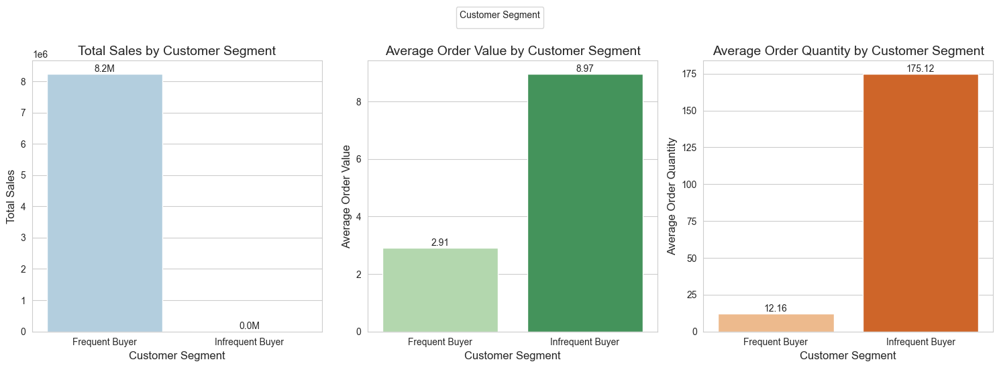

In [24]:
#Visualizing Customer Segmentation

#Calculate average order value
df['AverageOrderValue'] = df['TotalSales'] / df['Quantity']

#Group by segment and calculate relevant metrics
segment_stats = df.groupby('CustomerSegment').agg({
    'TotalSales': ['sum', 'mean'],
    'Quantity': ['sum', 'mean'],
    'AverageOrderValue': ['mean']
}).reset_index()

#Rename columns
segment_stats.columns = ['CustomerSegment', 'TotalSales_Sum', 'TotalSales_Mean', 'Quantity_Sum', 'Quantity_Mean', 'AverageOrderValue_Mean']

#Set the style for seaborn plots
sns.set_style('whitegrid')

#Create bar charts with enhanced aesthetics
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

#Total Sales by Customer Segment
sns.barplot(x='CustomerSegment', y='TotalSales_Sum', hue='CustomerSegment', data=segment_stats, palette='Blues', ax=axes[0])
axes[0].set_title('Total Sales by Customer Segment', fontsize=14)
axes[0].set_xlabel('Customer Segment', fontsize=12)
axes[0].set_ylabel('Total Sales', fontsize=12)
axes[0].tick_params(axis='both', labelsize=10)
for p in axes[0].patches:
    axes[0].annotate(f'{p.get_height() / 1e6:.1f}M', (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='bottom', fontsize=10)

#Average Order Value by Customer Segment
sns.barplot(x='CustomerSegment', y='AverageOrderValue_Mean', hue='CustomerSegment', data=segment_stats, palette='Greens', ax=axes[1])
axes[1].set_title('Average Order Value by Customer Segment', fontsize=14)
axes[1].set_xlabel('Customer Segment', fontsize=12)
axes[1].set_ylabel('Average Order Value', fontsize=12)
axes[1].tick_params(axis='both', labelsize=10)
for p in axes[1].patches:
    axes[1].annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='bottom', fontsize=10)

#Average Order Quantity by Customer Segment
sns.barplot(x='CustomerSegment', y='Quantity_Mean', hue='CustomerSegment', data=segment_stats, palette='Oranges', ax=axes[2])
axes[2].set_title('Average Order Quantity by Customer Segment', fontsize=14)
axes[2].set_xlabel('Customer Segment', fontsize=12)
axes[2].set_ylabel('Average Order Quantity', fontsize=12)
axes[2].tick_params(axis='both', labelsize=10)
for p in axes[2].patches:
    axes[2].annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha='center', va='bottom', fontsize=10)

#Manually add a legend
handles, labels = axes[0].get_legend_handles_labels()  # Get legend handles from the first subplot
fig.legend(handles, labels, loc='upper center', title='Customer Segment', bbox_to_anchor=(0.5, 1.1))  # Add legend to the figure

plt.tight_layout()
plt.show()

# Interpretation:

The bar charts reveal distinct purchasing behaviors between frequent and infrequent buyers. While infrequent buyers contribute significantly more to overall sales, their behavior is characterized by larger, less frequent orders with higher average order values and quantities. In contrast, frequent buyers generate smaller, more frequent orders with lower average order values and quantities.

However, it's important to note that the high average order values and quantities for infrequent buyers might be influenced by a small number of very large orders, potentially skewing the results.

In [25]:
#Profitability Analysis

#Function to visualize profitability by category
def plot_interactive_profitability_by_category(df, category_col, value_col, title, max_categories=10, color='lightcoral'):
    
    #Summing profitability for each category, sorted in descending order, and limiting to top categories
    category_profit = df.groupby(category_col)[value_col].sum().sort_values(ascending=False).head(max_categories)
    
    #Prepare the data
    category_profit_df = category_profit.reset_index()
    category_profit_df.columns = [category_col, 'ProfitMargin']  #Rename for clarity

    #Create the interactive bar chart with data labels
    fig = px.bar(
        category_profit_df,
        x=category_col,
        y='ProfitMargin',
        color=category_col,  #Color bars by category
        title=title,
        text='ProfitMargin',  #Display the profit margin as data labels
        labels={category_col: category_col, 'ProfitMargin': f'{value_col}'},
        color_discrete_sequence=[color]  #Custom colour for the bars
    )

    #Customize layout
    fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')  #Display data labels with 2 decimal places
    fig.update_layout(
        xaxis_title=category_col,
        yaxis_title=f'{value_col}',
        xaxis_tickangle=-45,  #Rotate x-axis labels for readability
        template='plotly_dark'  #dark theme
    )

    #Show the interactive plot
    fig.show()

#Analyze profitability by product category
plot_interactive_profitability_by_category(df, 'Description', 'ProfitMargin', 'Top 10 Product Categories by Profit Margin')

#Analyze profitability by country
plot_interactive_profitability_by_category(df, 'Country', 'ProfitMargin', 'Top 10 Countries by Profit Margin')

# Interpretation:

The analysis reveals a strong focus on high-profit product categories and the United Kingdom market. The "Regency Cakestand 3 Tier" stands out as a top-performing product category with a significantly higher profit margin compared to others. While the United Kingdom demonstrates significantly higher profitability, focusing solely on this market might limit growth potential. The company should also prioritize efforts to boost sales in other countries, particularly those with emerging potential, such as the Netherlands and EIRE, while maintaining its strong position in the United Kingdom.

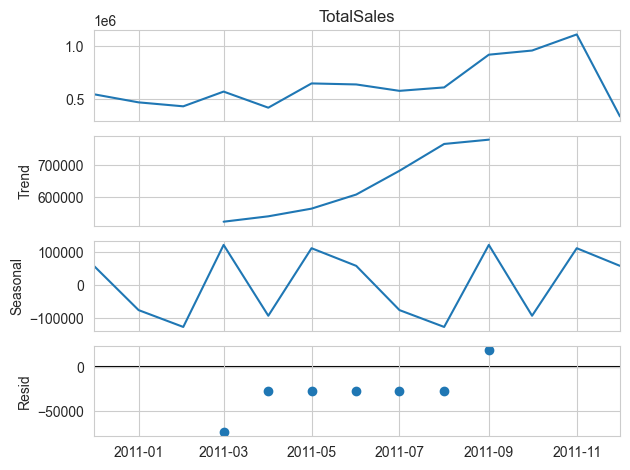

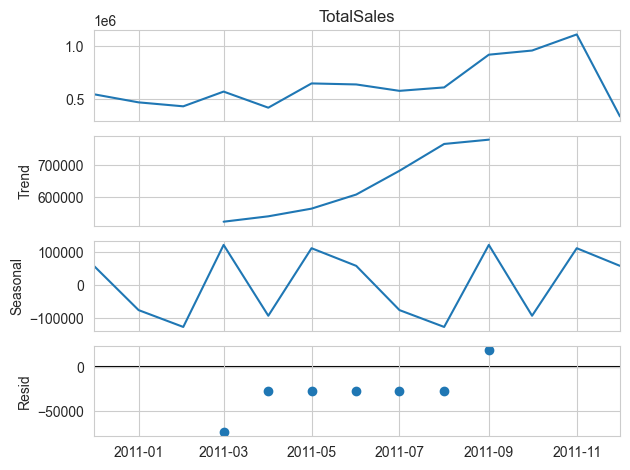

In [26]:
#Seasonal Decomposition

#Ensure 'InvoiceDate' is in datetime format
if isinstance(df['YearMonth'].dtype, pd.PeriodDtype):
    df['YearMonth'] = df['YearMonth'].dt.to_timestamp()

#Ensure 'YearMonth' is in datetime format
df['YearMonth'] = pd.to_datetime(df['YearMonth'], format='%Y-%m')

#Aggregate total sales by month
monthly_sales = df.groupby('YearMonth')['TotalSales'].sum()

#Perform seasonal decomposition
decomposition = seasonal_decompose(monthly_sales, model='additive', period=6)

#Plot decomposition results
decomposition.plot()

# Interpretation:

The time series decomposition reveals a combination of factors driving Total Sales. An upward trend indicates consistent growth over time, while a prominent seasonal component suggests significant fluctuations in sales likely influenced by factors such as holidays, weather patterns, or marketing campaigns. The presence of residuals indicates that there is some unexplained variation in sales that is not captured by the trend or seasonal components. This analysis provides valuable insights for forecasting future sales, optimizing inventory management, and tailoring marketing strategies to capitalize on seasonal trends and mitigate potential risks associated with fluctuations in demand.